# <font color = blue>[Data Cleaning + Feature Engineering]</font>

## <font color = blue>Import Packages + Data</font>

In [1]:
import pandas as pd
import numpy as np
import pandas_profiling as prof
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import datetime

from sklearn.feature_selection import SelectKBest, RFECV, SelectFromModel, VarianceThreshold, chi2
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor

In [2]:
final_df = pd.read_csv("./Prepared_Data/final_df.csv")

## <font color = blue>Exploring All Variables</font>

In [3]:
pd.set_option("display.max_rows", None)

In [4]:
final_df["delivery_delay_time"]=final_df["delivery_delay_time"].str.replace(" days","")
#Convert delay time to int, because machine learning model does not accept object 

In [5]:
final_df["delivery_delay_time"].head()

0    0
1    0
2    0
3    0
4    0
Name: delivery_delay_time, dtype: object

In [6]:
final_df["delivery_delay_time"]=final_df["delivery_delay_time"].astype(str).astype(int)

In [7]:
final_df.head()

,id,project_code,pq,po_so,asn_dn,country,managed_by,fulfill_via,vendor_inco_term,shipment_mode,...,timeliness,track_trace,origin_fsi,origin_customs,origin_infra,origin_intl_ship,origin_logistic_qlty,origin_lpi,origin_timeliness,origin_track_trace
0,1,100-CI-T01,Pre-PQ Process,SCMS-4,ASN-8,Côte d'Ivoire,PMO - US,Direct Drop,EXW,Air,...,3.25000,2.00000,70.4,2.69118,2.90476,3.07813,3.26563,3.070914,3.47458,3.03333
1,5243,104-CI-T01,Pre-PQ Process,SCMS-40,ASN-26,Côte d'Ivoire,PMO - US,Direct Drop,EXW,Air,...,3.25000,2.00000,70.4,2.69118,2.90476,3.07813,3.26563,3.070914,3.47458,3.03333
2,3,108-VN-T01,Pre-PQ Process,SCMS-13,ASN-85,Vietnam,PMO - US,Direct Drop,EXW,Air,...,3.22222,2.90000,70.4,2.69118,2.90476,3.07813,3.26563,3.070914,3.47458,3.03333
3,16,108-VN-T01,Pre-PQ Process,SCMS-81,ASN-55,Vietnam,PMO - US,Direct Drop,EXW,Air,...,3.22222,2.90000,70.4,2.69118,2.90476,3.07813,3.26563,3.070914,3.47458,3.03333
4,23,112-NG-T01,Pre-PQ Process,SCMS-87,ASN-57,Nigeria,PMO - US,Direct Drop,EXW,Air,...,2.69048,2.35556,70.4,2.69118,2.90476,3.07813,3.26563,3.070914,3.47458,3.03333


In [8]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10324 entries, 0 to 10323
Data columns (total 72 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   id                                   10324 non-null  int64  
 1   project_code                         10324 non-null  object 
 2   pq                                   10324 non-null  object 
 3   po_so                                10324 non-null  object 
 4   asn_dn                               10324 non-null  object 
 5   country                              10324 non-null  object 
 6   managed_by                           10324 non-null  object 
 7   fulfill_via                          10324 non-null  object 
 8   vendor_inco_term                     10324 non-null  object 
 9   shipment_mode                        10324 non-null  object 
 10  scheduled_delivery_date              10324 non-null  object 
 11  delivered_to_client_date    

In [9]:
object_df = final_df[['country','managed_by','fulfill_via','vendor_inco_term','shipment_mode','product_group','sub_classification',
                             'vendor','brand','dosage_form','first_line_designation','dosage','weight_captured_seperately','freight_invoiced_seperately',
                      'freight_in_commodity_cost','origin_country','origin_continent']]


In [10]:
object_df.nunique(axis=0)

country                        43
managed_by                      4
fulfill_via                     2
vendor_inco_term                8
shipment_mode                   5
product_group                   5
sub_classification              6
vendor                         73
brand                          48
dosage_form                    17
first_line_designation          2
dosage                         55
weight_captured_seperately      2
freight_invoiced_seperately     2
freight_in_commodity_cost       2
origin_country                 22
origin_continent                5
dtype: int64

In [11]:
num_df = final_df[['delivery_delay_time','line_item_quantity','line_item_insurance_usd','weight_calculated','freight_cost_calculated','line_item_value',
                   'scheduled_delivery_date_y','scheduled_delivery_date_m','scheduled_delivery_date_d','fsi','customs',
                    'infra','intl_ship','logistic_qlty','lpi','timeliness','track_trace','origin_fsi','origin_customs','origin_infra','origin_intl_ship','origin_logistic_qlty','origin_lpi','origin_timeliness','origin_track_trace']]

In [12]:
trend_df = final_df[['scheduled_delivery_date_weekday','scheduled_delivery_date_weekofyear','scheduled_delivery_date_quarter'
                     ,'scheduled_delivery_date_y','scheduled_delivery_date_m','scheduled_delivery_date_d']]

In [13]:
analysis_df = final_df[['country','managed_by','fulfill_via','vendor_inco_term','shipment_mode','product_group','sub_classification',
                             'vendor','brand','dosage_form','first_line_designation','dosage','weight_captured_seperately','freight_invoiced_seperately',
                      'freight_in_commodity_cost','delivery_delay_time','origin_country','origin_continent','line_item_quantity','line_item_insurance_usd','weight_calculated','freight_cost_calculated','line_item_value',
                   'scheduled_delivery_date_y','scheduled_delivery_date_m','scheduled_delivery_date_d','fsi','customs',
                    'infra','intl_ship','logistic_qlty','lpi','timeliness','track_trace']]

In [14]:
prof.ProfileReport(analysis_df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### The correlation shows that those World Logistic Performance Indexs including 'customs', 'infra' ... have strong positive correlations.
### Also,  item insurance and item value also have high positive correlation.

### PCA can help check this high correlation's effect.

## <font color = blue>Imbalance Label</font>

In [15]:
# Explore the label 'delayed'
final_df.delayed.value_counts()
#This is imbalanced (1186/9138 = 12.98%)

False    9138
True     1186
Name: delayed, dtype: int64

### We can use cross validation to oversample the dataset in order to deal with imbalaced labels.

## <font color = blue>Explore Numeric Data by Data Type</font>

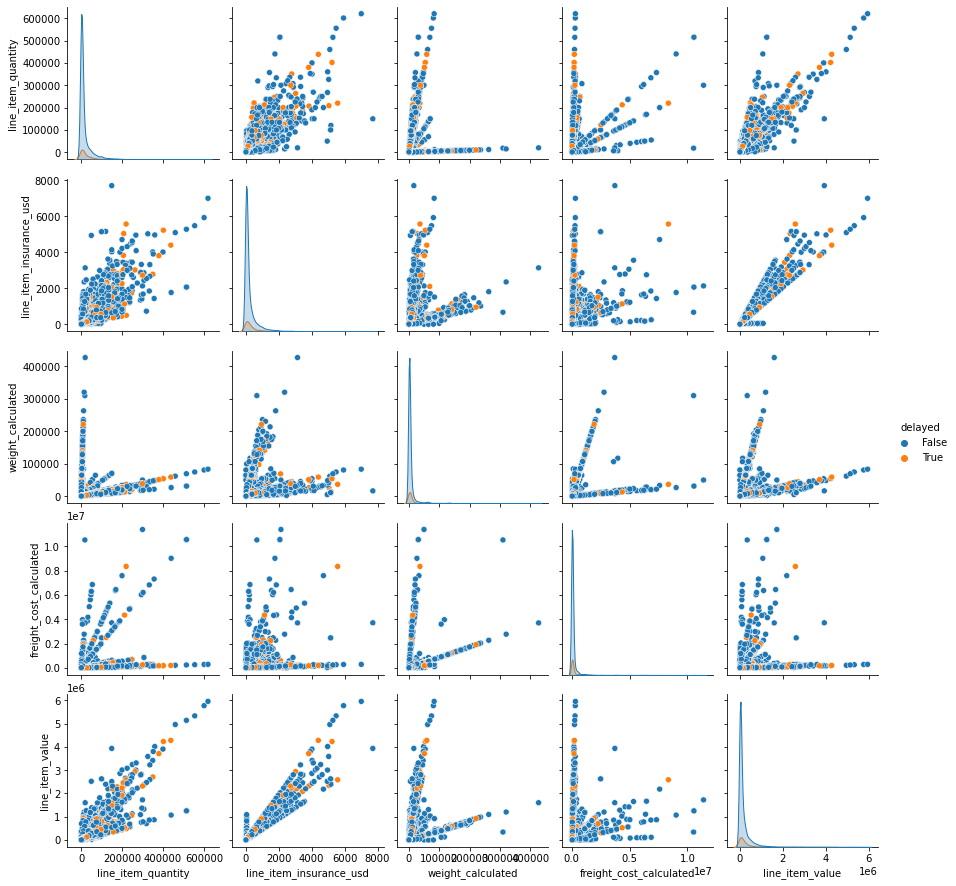

In [15]:
num_df_target_1 = final_df[['line_item_quantity','line_item_insurance_usd','weight_calculated','freight_cost_calculated','line_item_value',
                   'delayed']]
sns.pairplot(num_df_target_1, hue='delayed', diag_kind ='kde')


### Those delayed item have common in low item quantity, low insurance, low weight, low freight cost and low item value.

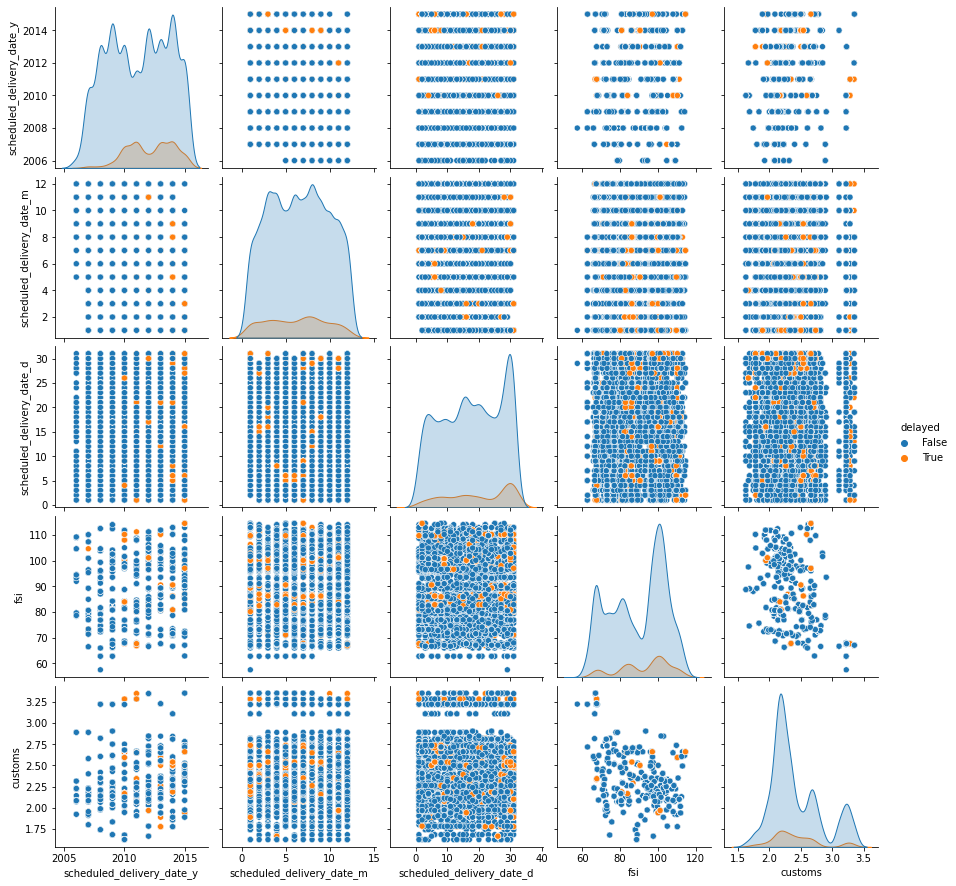

In [8]:
num_df_target_2 = final_df[['scheduled_delivery_date_y','scheduled_delivery_date_m','scheduled_delivery_date_d','fsi','customs',
                   'delayed']]
sns.pairplot(num_df_target_2, hue='delayed', diag_kind ='kde')


### Those delayed item have some common trend in scheduled delivery date.

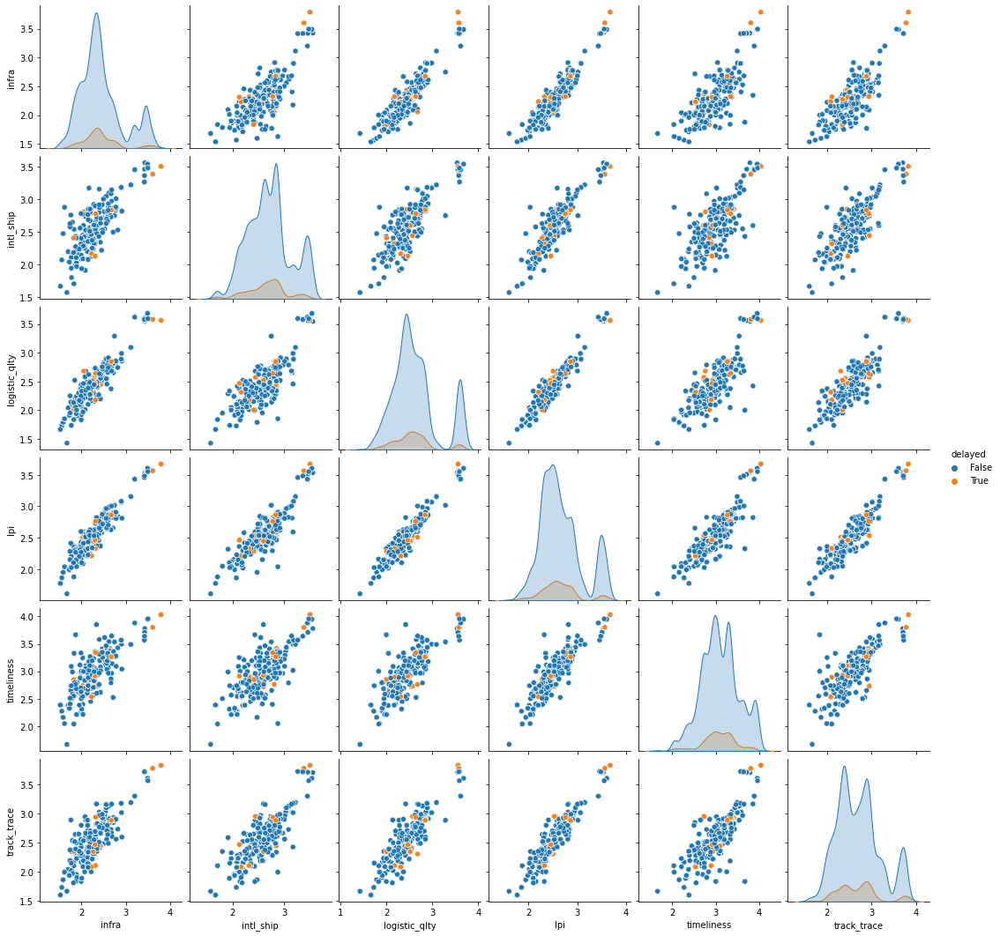

In [9]:
num_df_target_3 = final_df[['infra','intl_ship','logistic_qlty','lpi','timeliness','track_trace','delayed']]
sns.pairplot(num_df_target_3, hue='delayed', diag_kind ='kde')


### Those delayed item also have some common trend in LPI index.
### It seems that some numerical variables have high correlation with each other, so that PCA will be later applied to reduce some variable.

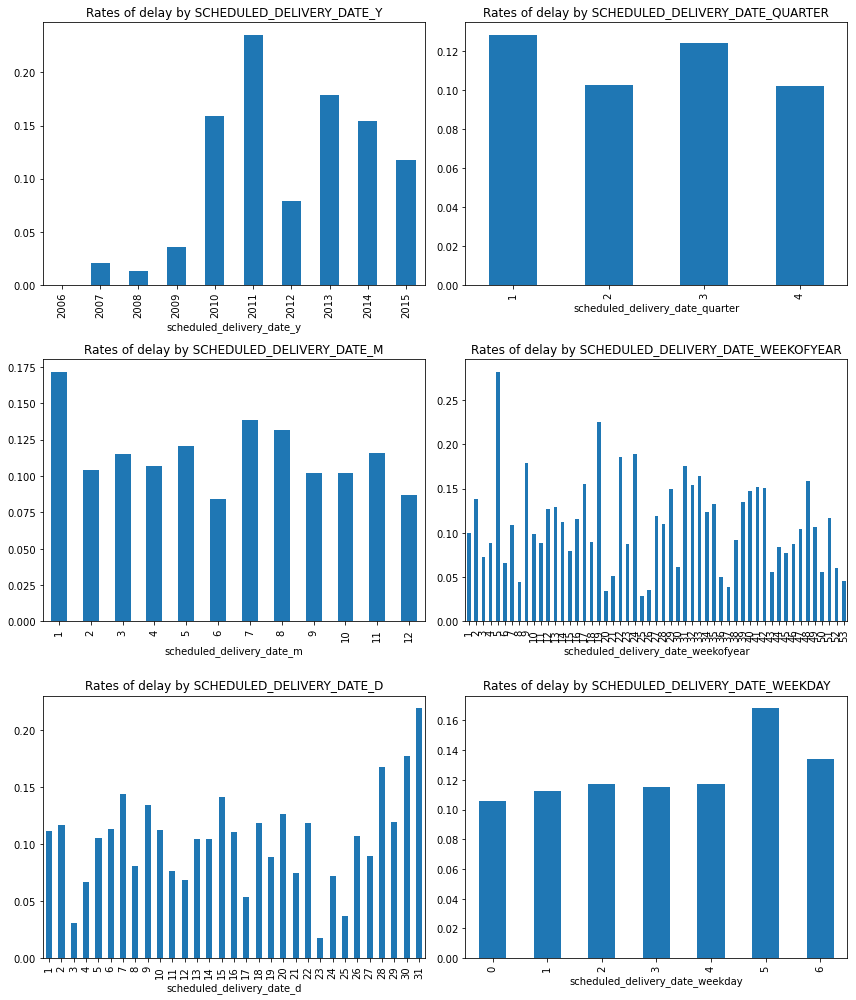

In [63]:
#Time Trend Data Exploration
final_del = final_df[['delayed','scheduled_delivery_date_weekday','scheduled_delivery_date_weekofyear','scheduled_delivery_date_quarter'
                     ,'scheduled_delivery_date_y','scheduled_delivery_date_m','scheduled_delivery_date_d']]

# Plot
tcols = ['scheduled_delivery_date_y','scheduled_delivery_date_quarter'
 ,'scheduled_delivery_date_m', 'scheduled_delivery_date_weekofyear', 'scheduled_delivery_date_d','scheduled_delivery_date_weekday'] 
fig, ((ax0,ax1), (ax2,ax3),(ax4,ax5))= plt.subplots(nrows=3,ncols=2,figsize=(12,14))
axes = [ax0,ax1, ax2,ax3,ax4,ax5]
for i in range(len(tcols)):
    final_del.groupby(tcols[i]).agg('mean')['delayed'].plot(kind="bar", ax=axes[i]
                                        ,title = "Rates of delay by "+tcols[i].upper())
plt.tight_layout()

### From the visulization of time trend data, we can see that 2011 has the highest rate of late delivery among all years; January has the highest rate of late delivery; The fifth week of a month has the highest rate of late delivery; 31st has the highest rate of late delivery; Friday has the highest rate of late delivery.

## <font color = blue>Explore Categorical Data</font>

In [18]:
brand_df = pd.read_csv("./Prepared_Data/brand_df.csv")
country_df = pd.read_csv("./Prepared_Data/country_df.csv")
factory_df = pd.read_csv("./Prepared_Data/factory_df.csv")
vendor_df = pd.read_csv("./Prepared_Data/vendor_df.csv")
molecule_test_df = pd.read_csv("./Prepared_Data/molecule_test_df.csv")

In [49]:
#brand_df = brand_df.drop(columns=['brand_pricesum.1','brand_pricecount.1','brand_pricemean.1','brand_calculatedsum.1','brand_calculatedcount.1','brand_calculatedmean.1'])
#country_df = country_df.drop(columns=['country_pricesum.1','country_pricecount.1','country_pricemean.1','country_calculatedsum.1','country_calculatedcount.1','country_calculatedmean.1'])
#factory_df = factory_df.drop(columns=['manufacturing_site_pricesum.1','manufacturing_site_pricecount.1','manufacturing_site_pricemean.1','manufacturing_site_calculatedsum.1','manufacturing_site_calculatedcount.1','manufacturing_site_calculatedmean.1'])
#vendor_df = vendor_df.drop(columns=['vendor_pricesum.1','vendor_pricecount.1','vendor_pricemean.1','vendor_calculatedsum.1','vendor_calculatedcount.1','vendor_calculatedmean.1'])
#molecule_test_df = molecule_test_df.drop(columns=['molecule_test_type_pricesum.1','molecule_test_type_pricecount.1','molecule_test_type_pricemean.1','molecule_test_type_calculatedsum.1','molecule_test_type_calculatedcount.1','molecule_test_type_calculatedmean.1'])


In [54]:
delayed=pd.to_numeric(final_df.delayed)

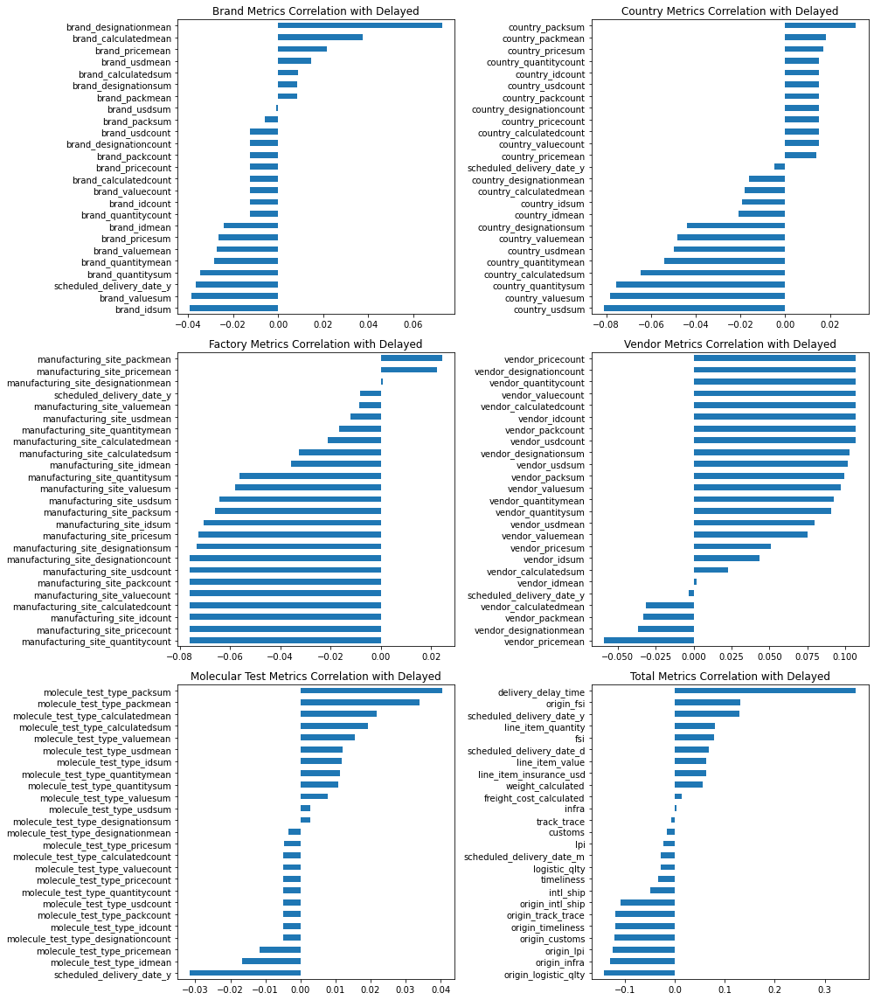

In [66]:
ndfs = [brand_df, country_df, factory_df, vendor_df, molecule_test_df, num_df]
ttl = ['Brand','Country', 'Factory','Vendor', 'Molecular Test', 'Total']
fig, ((ax0, ax1),(ax2,ax3),(ax4,ax5))= plt.subplots(nrows=3,ncols=2,figsize=(14,16))
axes = [ax0, ax1,ax2,ax3,ax4,ax5]
for i in range(len(ndfs)):
    pd.concat([ndfs[i],delayed], axis=1).corr().delayed.drop("delayed").sort_values().plot(kind='barh'
                ,title= ttl[i]+" Metrics Correlation with Delayed" ,ax = axes[i])
plt.tight_layout()

## <font color = blue>Machine Learning Trial</font>

In [46]:
from sklearn.preprocessing import FunctionTransformer,PolynomialFeatures, normalize
from sklearn.preprocessing import MinMaxScaler, LabelEncoder, OneHotEncoder, LabelBinarizer ,StandardScaler
from sklearn.pipeline import TransformerMixin, _BaseComposition 
from sklearn.pipeline import FeatureUnion, make_pipeline, Pipeline
from sklearn.model_selection import train_test_split
from sklearn import metrics 
from sklearn.metrics import mean_squared_error
import category_encoders as ce


from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from imblearn.over_sampling import SMOTE

- ## <font color = blue>Random Forest Regression</font>

In [16]:
analysis_df=final_df[['country','managed_by','fulfill_via','vendor_inco_term','shipment_mode','product_group','sub_classification',
                             'vendor','brand','dosage_form','first_line_designation','dosage','weight_captured_seperately','freight_invoiced_seperately',
                      'freight_in_commodity_cost','origin_country','origin_continent','delivery_delay_time','line_item_quantity','line_item_insurance_usd','weight_calculated','freight_cost_calculated','line_item_value',
                   'scheduled_delivery_date_y','scheduled_delivery_date_m','scheduled_delivery_date_d','fsi','customs',
                    'infra','intl_ship','logistic_qlty','lpi','timeliness','track_trace','origin_fsi','origin_customs','origin_infra','origin_intl_ship','origin_logistic_qlty','origin_lpi','origin_timeliness','origin_track_trace',
                     'scheduled_delivery_date_weekday','scheduled_delivery_date_weekofyear','scheduled_delivery_date_quarter'
                     ,'scheduled_delivery_date_y','scheduled_delivery_date_m','scheduled_delivery_date_d']]

In [19]:
#Encode the Categorical variables
OHE = ce.OneHotEncoder(cols=['country','managed_by','fulfill_via','vendor_inco_term','shipment_mode','product_group','sub_classification',
                             'vendor','brand','dosage_form','first_line_designation','dosage','weight_captured_seperately','freight_invoiced_seperately',
                      'freight_in_commodity_cost','origin_country','origin_continent',],use_cat_names=True)
# encode the categorical variables
df1 = OHE.fit_transform(final_df)

In [20]:
# Scale the continuous data
pipe = make_pipeline(StandardScaler())
pipe.fit(df1[['delivery_delay_time','line_item_quantity','line_item_insurance_usd','weight_calculated','freight_cost_calculated','line_item_value',
                   'scheduled_delivery_date_y','scheduled_delivery_date_m','scheduled_delivery_date_d','fsi','customs',
                    'infra','intl_ship','logistic_qlty','lpi','timeliness','track_trace','origin_fsi','origin_customs','origin_infra','origin_intl_ship','origin_logistic_qlty','origin_lpi','origin_timeliness','origin_track_trace',
             'scheduled_delivery_date_weekday','scheduled_delivery_date_weekofyear','scheduled_delivery_date_quarter'
                     ,'scheduled_delivery_date_y','scheduled_delivery_date_m','scheduled_delivery_date_d']])

Pipeline(steps=[('standardscaler', StandardScaler())])

In [34]:
#Build Model

# separate the independent and target variable 
train_X = df1.drop(columns=['delayed','delivery_delay_time','manufacturing_site','id','project_code','po_so','pq','asn_dn','item_description','molecule_test_type',
                           'line_item_value','unit_price','pack_price','delivered_to_client_date_y','delivered_to_client_date_m',
                            'delivered_to_client_date_d','delivery_recorded_date_y','delivery_recorded_date_m','delivery_recorded_date_d',
                            'delivered_to_client_date_weekday','delivered_to_client_date_weekofyear','delivered_to_client_date_quarter',
                            'delivery_recorded_date_weekday','delivery_recorded_date_weekofyear','delivery_recorded_date_quarter',
                            'scheduled_delivery_date','delivered_to_client_date','delivery_recorded_date'])
train_Y = df1['delivery_delay_time']

# randomly split the data
train_x, test_x, train_y, test_y = train_test_split(train_X, train_Y,test_size=0.25,random_state=42)

# shape of train and test splits
train_x.shape, test_x.shape, train_y.shape, test_y.shape

((7743, 328), (2581, 328), (7743,), (2581,))

In [38]:
# create an object of the RandomForestRegressor
model_RFR = RandomForestRegressor(max_depth=10,random_state=2)

# fit the model with the training data
model_RFR.fit(train_x, train_y)

# predict the target on train and test data
predict_train = model_RFR.predict(train_x)
predict_test = model_RFR.predict(test_x)

# Root Mean Squared Error on train and test data
print('RMSE on train data: ', mean_squared_error(train_y, predict_train)**(0.5))
print('RMSE on test data: ',  mean_squared_error(test_y, predict_test)**(0.5))

RMSE on train data:  14.953148108123887
RMSE on test data:  18.972003146601896


- ## <font color = blue>Feature Importance for Regression Model</font>

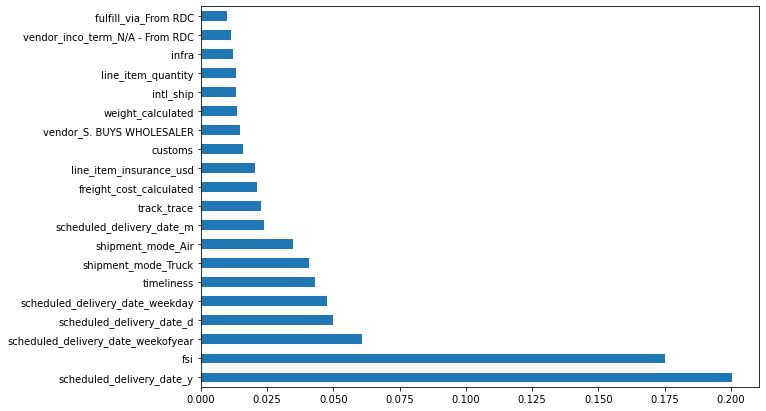

In [39]:
plt.figure(figsize=(10,7))
feat_importances = pd.Series(model_RFR.feature_importances_, index = train_x.columns)
feat_importances.nlargest(20).plot(kind='barh');

### The feature importance shows that the year of scheduled delivery date contribute most to predict the delay time of an item. The second importance feature is the Fragile State Index of the consumer country (the consumer side).

- ## <font color = blue>Random Forest Classification</font>

In [41]:
#Build Model

# separate the independent and target variable 
train_X = df1.drop(columns=['delayed','delivery_delay_time','manufacturing_site','id','project_code','po_so','pq','asn_dn','item_description','molecule_test_type',
                           'line_item_value','unit_price','pack_price','delivered_to_client_date_y','delivered_to_client_date_m',
                            'delivered_to_client_date_d','delivery_recorded_date_y','delivery_recorded_date_m','delivery_recorded_date_d',
                            'delivered_to_client_date_weekday','delivered_to_client_date_weekofyear','delivered_to_client_date_quarter',
                            'delivery_recorded_date_weekday','delivery_recorded_date_weekofyear','delivery_recorded_date_quarter',
                            'scheduled_delivery_date','delivered_to_client_date','delivery_recorded_date'])
train_Y = df1['delayed']

# randomly split the data
train_x, test_x, train_y, test_y = train_test_split(train_X, train_Y,test_size=0.25,random_state=42)

# shape of train and test splits
train_x.shape, test_x.shape, train_y.shape, test_y.shape

#SMOTE for imbalanced data
sm = SMOTE(random_state=42)
train_x_sm, train_y_sm = sm.fit_resample(train_x, train_y)
print('After OverSampling, the shape of train_X: {}'.format(train_x_sm.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(train_y_sm.shape))
  
print("After OverSampling, counts of label '1': {}".format(sum(train_y_sm == True)))
print("After OverSampling, counts of label '0': {}".format(sum(train_y_sm == False)))


After OverSampling, the shape of train_X: (13728, 328)
After OverSampling, the shape of train_y: (13728,) 

After OverSampling, counts of label '1': 6864
After OverSampling, counts of label '0': 6864


In [47]:
# create an object of the RandomForestclassifier
model_RFC = RandomForestClassifier(n_estimators = 100)

# fit the model with the training data
model_RFC.fit(train_x_sm, train_y_sm)

# performing predictions on the test dataset
y_pred = model_RFC.predict(test_x)
 
# using metrics module for accuracy calculation
print("ACCURACY OF THE MODEL: ", metrics.accuracy_score(test_y, y_pred))

ACCURACY OF THE MODEL:  0.8996512979465323


- ## <font color = blue>Feature Importance for Classification Model</font>

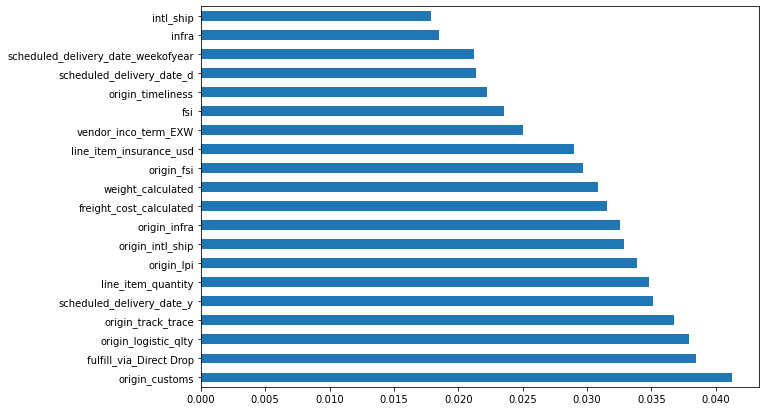

In [48]:
plt.figure(figsize=(10,7))
feat_importances = pd.Series(model_RFC.feature_importances_, index = train_x_sm.columns)
feat_importances.nlargest(20).plot(kind='barh');

### The feature importance of Classification Model shows that the customs index of original country contribute most to predict if an item is delayed. 

### Here we have a preliminary understanding of the contribution of variables, and in the next section, more machine learning methods for classification and regression prediction will be applied to further explore the main factors contributing to delayed delivery in the hiv drug supply chain.

## <font color = blue>Principal Components Analysis (PCA)</font>

In [57]:
from sklearn.decomposition import PCA

In [50]:
#Use numerical variables to do the PCA
pca_df = final_df[['delayed','line_item_quantity','line_item_insurance_usd','weight_calculated','freight_cost_calculated','line_item_value',
                   'scheduled_delivery_date_y','scheduled_delivery_date_m','scheduled_delivery_date_d','fsi','customs',
                    'infra','intl_ship','logistic_qlty','lpi','timeliness','track_trace','origin_fsi','origin_customs',
                   'origin_infra','origin_intl_ship','origin_logistic_qlty','origin_lpi','origin_timeliness','origin_track_trace']]


In [51]:
pca_df_num = pca_df.drop(columns=['delayed'])

In [52]:
# Scale the continuous data
pipe = make_pipeline(StandardScaler())
pipe.fit(pca_df_num)

Pipeline(steps=[('standardscaler', StandardScaler())])

In [53]:
features = list(pca_df_num.columns.values)
features  #24 variables

['line_item_quantity',
 'line_item_insurance_usd',
 'weight_calculated',
 'freight_cost_calculated',
 'line_item_value',
 'scheduled_delivery_date_y',
 'scheduled_delivery_date_m',
 'scheduled_delivery_date_d',
 'fsi',
 'customs',
 'infra',
 'intl_ship',
 'logistic_qlty',
 'lpi',
 'timeliness',
 'track_trace',
 'origin_fsi',
 'origin_customs',
 'origin_infra',
 'origin_intl_ship',
 'origin_logistic_qlty',
 'origin_lpi',
 'origin_timeliness',
 'origin_track_trace']

In [54]:
# Separating out the features
x_pca = pca_df.loc[:, features].values
# Separating out the target
y_pca = pca_df.loc[:,['delayed']].values

In [55]:
np.set_printoptions(suppress=True)

In [81]:
pcamodel = PCA(n_components=4)

model = pcamodel.fit(x_pca)
X_pc = model.transform(x_pca)

# number of components
n_pcs= model.components_.shape[0]

# get the index of the most important feature on EACH component
# LIST COMPREHENSION HERE
most_important = [np.abs(model.components_[i]).argmax() for i in range(n_pcs)]

initial_feature_names = features

# get the names
most_important_names = [initial_feature_names[most_important[i]] for i in range(n_pcs)]

# LIST COMPREHENSION HERE AGAIN
dic = {'PC{}'.format(i+1): most_important_names[i] for i in range(n_pcs)}

# build the dataframe
pca_importance_df_1 = pd.DataFrame(sorted(dic.items()))

In [82]:
pcamodel.explained_variance_ratio_

array([0.69840812, 0.2994688 , 0.00151328, 0.00060975])

In [83]:
pcamodel.explained_variance_ratio_[:4].sum()

0.9999999453412288

In [84]:
pca_importance_df_1

,0,1
0,PC1,freight_cost_calculated
1,PC2,line_item_value
2,PC3,line_item_quantity
3,PC4,weight_calculated


- ### <font color = blue>The explained variance ratio shows that the first principal component explain 69.8% of the data, which explains the most among all the principal components.</font>
- ### <font color = blue>The first four principal component explain 99.99% of the data, which is very significant to explain the model..</font>

- ### <font color = blue>The most influential variable in PC1 is the <b>freight cost</b>.</font> 
- ### <font color = blue>The most influential variable in PC2 is the <b>value per item</b>.</font> 
- ### <font color = blue>The most influential variable in PC1 is the <b>quantity of item</b>.</font> 
- ### <font color = blue>The most influential variable in PC1 is the <b>weight</b>.</font> 


In [85]:
#pca = PCA(n_components=6).fit(x_pca)
pca_importance_df = pd.DataFrame(pcamodel.components_,columns=initial_feature_names,index = ['PC-1','PC-2','PC-3','PC-4'])
pca_importance_df

,line_item_quantity,line_item_insurance_usd,weight_calculated,freight_cost_calculated,line_item_value,scheduled_delivery_date_y,scheduled_delivery_date_m,scheduled_delivery_date_d,fsi,customs,...,timeliness,track_trace,origin_fsi,origin_customs,origin_infra,origin_intl_ship,origin_logistic_qlty,origin_lpi,origin_timeliness,origin_track_trace
PC-1,0.039661,0.000484,0.019043,0.948027,0.315134,1.502109e-07,9.667118e-08,-2.235125e-07,-8.765268e-07,3.264986e-08,...,4.316549e-08,6.612149e-08,-5.384204e-07,2.535032e-10,-1.838811e-08,-1.412367e-08,-1.183512e-09,-6.074067e-09,-6.736810e-09,1.045544e-09
PC-2,0.085258,0.001254,0.010365,-0.317672,0.944302,7.078043e-07,-3.024776e-08,1.306825e-06,2.364955e-06,-1.179954e-07,...,-7.907256e-08,-1.114160e-07,8.035836e-06,-1.368706e-07,-1.532668e-07,-7.074130e-08,-1.283584e-07,-1.176741e-07,-9.858589e-08,-1.322786e-07
PC-3,-0.843431,0.000364,0.532567,0.001095,0.070673,-2.302597e-06,-1.186499e-06,-1.502132e-05,4.709192e-05,-1.592909e-06,...,-1.165053e-06,-1.434698e-06,-3.704135e-04,6.823484e-06,6.721784e-06,3.403373e-06,5.562859e-06,5.370120e-06,3.955120e-06,6.284551e-06
PC-4,-0.528944,0.001404,-0.846109,0.018134,0.063142,-2.199905e-05,-4.573305e-06,1.775161e-05,-4.486335e-05,-1.186119e-07,...,-1.047801e-06,-1.230172e-06,1.158734e-04,-1.294993e-06,-2.161269e-07,-3.621929e-07,-6.033343e-07,-6.716559e-07,-2.993109e-07,-1.150731e-06


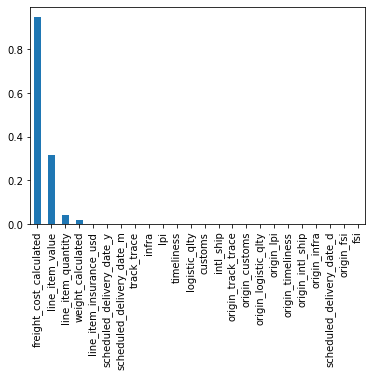

In [86]:
#PC-1 Feature Importance
pca_importance_df.iloc[0].sort_values(ascending=False).plot(kind = 'bar')
plt.show()

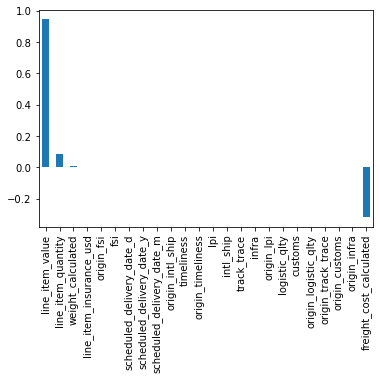

In [87]:
#PC-2 Feature Importance
pca_importance_df.iloc[1].sort_values(ascending=False).plot(kind = 'bar')
plt.show()

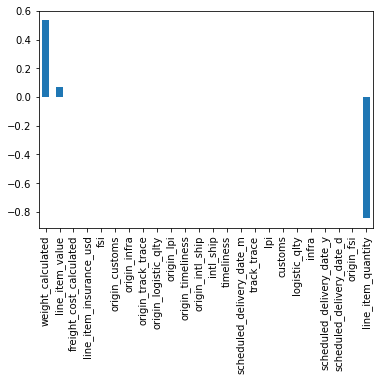

In [88]:
#PC-3 Feature Importance
pca_importance_df.iloc[2].sort_values(ascending=False).plot(kind = 'bar')
plt.show()

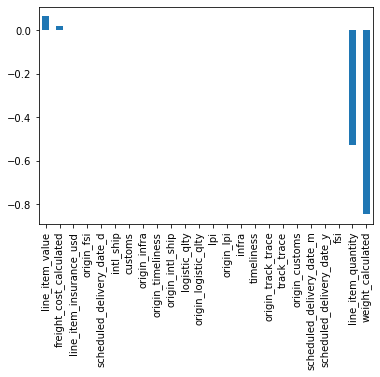

In [89]:
#PC-4 Feature Importance\
pca_importance_df.iloc[3].sort_values(ascending=False).plot(kind = 'bar')
plt.show()

### Delete line_item_value because it has high correlation with freight_cost_calculated, and they both explain for the same dimension of delayed time.

### From the feature importance of the four dimensions of PCA, we can see that those product side details, like weight and freight cost explain a lot to the label 'dalayed'. 
### We also have categorical data and trend data which contain the information from supply side and customer side, In the next section, the performance of these variables on machine learning models will be discussed specifically.

In [90]:
ml_df = final_df.drop(columns=['line_item_value'])

In [91]:
ml_df.to_csv("./Prepared_Data/ml_df.csv", index=False)